In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


## wczytanie zdjęć

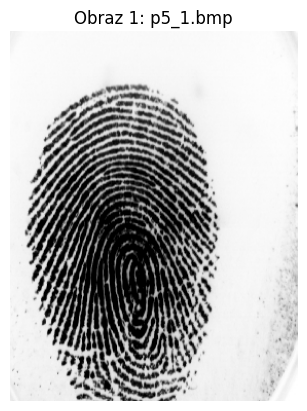

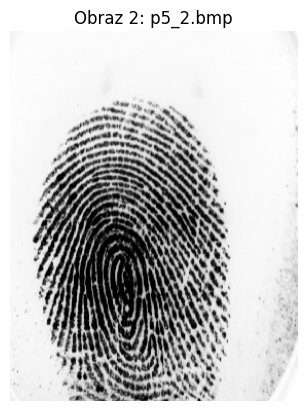

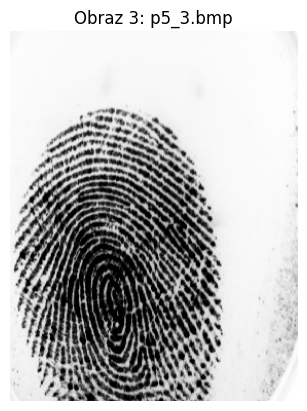

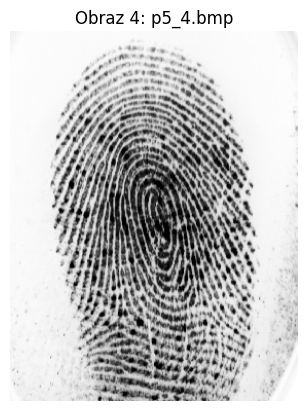

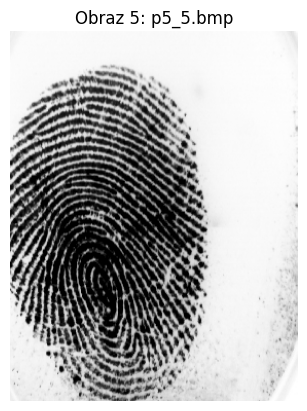

In [ ]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

folder_path = '/content/drive/MyDrive/biometria/skany/'
bmp_files = [f for f in os.listdir(folder_path) if f.lower().endswith('.bmp')]

images = []
for fname in bmp_files:
    path = os.path.join(folder_path, fname)
    img = Image.open(path).convert('L')
    img_array = np.array(img)
    images.append(img_array)

for i, img_array in enumerate(images[:5]):
    plt.figure()
    plt.title(f'Obraz {i+1}: {bmp_files[i]}')
    plt.imshow(img_array, cmap='gray')
    plt.axis('off')
    plt.show()


In [ ]:
print(images[1])

[[240 241 243 ... 245 250 251]
 [241 242 244 ... 243 249 251]
 [240 243 242 ... 241 246 248]
 ...
 [238 236 240 ... 254 254 254]
 [240 237 238 ... 254 254 254]
 [241 240 236 ... 254 254 254]]


## operacje morfologiczne

In [ ]:
import pandas as pd
import cv2

In [ ]:
def erosion(image, kernel):
    eroded_image = np.zeros_like(image)

    h, w = image.shape
    kh, kw = kernel.shape
    pad_h, pad_w = kh // 2, kw // 2

    for i in range(pad_h, h - pad_h):
        for j in range(pad_w, w - pad_w):

            region = image[i - pad_h:i + pad_h + 1, j - pad_w:j + pad_w + 1]
            if np.all(region[kernel == 1] == 0):
                eroded_image[i, j] = 0
            else:
                eroded_image[i, j] = 1
    return eroded_image


def dilation(image, kernel):
    dilated_image = np.zeros_like(image)
    h, w = image.shape
    kh, kw = kernel.shape
    pad_h, pad_w = kh // 2, kw // 2
    for i in range(pad_h, h - pad_h):
        for j in range(pad_w, w - pad_w):
            region = image[i - pad_h:i + pad_h + 1, j - pad_w:j + pad_w + 1]
            if np.any(region[kernel == 1] == 0):
                dilated_image[i, j] = 0
            else:
                dilated_image[i, j] = 1
    return dilated_image

def opening(image, kernel):
    eroded = erosion(image, kernel)
    return dilation(eroded, kernel)

def closing(image, kernel):
    dilated = dilation(image, kernel)
    return erosion(dilated, kernel)

def load_image(image_path):
    image = np.array(Image.open(image_path))
    return image

def display_image(image_array):
    if image_array.ndim == 2:
        plt.imshow(image_array, cmap='gray')
    else:
        plt.imshow(image_array)
    plt.axis('off')
    plt.show()

def to_grey_scale(image_array):
    if image_array.ndim == 3 and image_array.shape[2] >= 3:
        r, g, b = image_array[..., 0], image_array[..., 1], image_array[..., 2]
        greyscale = 0.299 * r + 0.587 * g + 0.114 * b
        return greyscale.astype(np.uint8)
    else:
        return image_array

def denoise(image_array):
    return cv2.GaussianBlur(image_array, (5, 5), 0)

def preprocess(image_array):
    image_array = enhance_contrast(image_array)
    return image_array

def binarize(image_array, delta=1.1):
    pre = preprocess(image_array)
    otsu_thresh = otsu_threshold(pre)
    adjusted_thresh = min(255, otsu_thresh * delta)
    binary = np.where(pre >= adjusted_thresh, 255, 0).astype(np.uint8)
    return binary

def otsu_threshold(image_array):
    hist, bins = np.histogram(image_array.flatten(), bins=256, range=(0, 256))
    total = image_array.size
    current_max, threshold = 0, 0
    sum_total, sum_foreground = 0, 0
    weight_background, weight_foreground = 0, 0

    for i in range(256):
        sum_total += i * hist[i]

    for i in range(256):
        weight_background += hist[i]
        if weight_background == 0:
            continue
        weight_foreground = total - weight_background
        if weight_foreground == 0:
            break
        sum_foreground += i * hist[i]
        mean_background = sum_foreground / weight_background
        mean_foreground = (sum_total - sum_foreground) / weight_foreground
        between_class_variance = weight_background * weight_foreground * (mean_background - mean_foreground) ** 2
        if between_class_variance > current_max:
            current_max = between_class_variance
            threshold = i
    return threshold


def binarize_adaptive(image_array):
    return cv2.adaptiveThreshold(
        image_array,
        255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY,
        blockSize=11,
        C=2
    )

def sobel_operator(image):
        if len(image.shape) == 3:
            image = self.to_greyscale(image)

        # dla 0 stopni
        kernel_x = np.array([[1, 0, -1],
                             [2, 0, -2],
                             [1, 0, -1]])

        # dla 90 stopni
        kernel_y = np.array([[1, 2, 1],
                             [0, 0, 0],
                             [-1, -2, -1]])

        grad_x = convolve(image, kernel_x)
        grad_y = convolve(image, kernel_y)

        sobel = np.sqrt(grad_x.astype(np.float32) ** 2 + grad_y.astype(np.float32) ** 2)
        sobel = np.clip(sobel, 0, 255).astype(np.uint8)

        return np.stack((sobel,) * 3, axis=-1)

def apply_gaussian_filter(image, sigma=1.0, kernel_size=5):
        ax = np.linspace(-(kernel_size - 1) / 2., (kernel_size - 1) / 2., kernel_size)
        gauss = np.exp(-0.5 * (ax / sigma) ** 2)
        kernel = np.outer(gauss, gauss)
        kernel /= np.sum(kernel)
        return convolve(image, kernel)

def convolve(image, kernel):
        if len(image.shape) == 3:
            return np.stack([self.convolve_channel(image[..., c], kernel) for c in range(3)], axis=-1)
        else:
            return convolve_channel(image, kernel)

    def convolve_channel(channel, kernel):
        kh, kw = kernel.shape
        ph, pw = kh // 2, kw // 2
        padded = np.pad(channel, ((ph, ph), (pw, pw)), mode='reflect')
        output = np.zeros_like(channel)

        for i in range(channel.shape[0]):
            for j in range(channel.shape[1]):
                region = padded[i:i + kh, j:j + kw]
                output[i, j] = np.sum(region * kernel)

        return np.clip(output, 0, 255).astype(np.uint8)

## Szkieletyzacja morfologiczna

In [ ]:
class MorphologicalSkeleton:

    def __init__(self):
        self.name = "Morfologiczna szkieletyzacja (klasyczna)"
        self.structuring_element = np.array([[0, 1, 0],
                                             [1, 1, 1],
                                             [0, 1, 0]], dtype=np.uint8)

    def thin(self, binary_image):
        img = binary_image.copy().astype(bool)
        skeleton = np.zeros_like(img, dtype=bool)
        eroded = img.copy()

        while True:
            opened = opening(eroded, self.structuring_element)
            temp = eroded & ~opened
            skeleton |= temp
            eroded = erosion(eroded, self.structuring_element)

            if not eroded.any():
                break

        return skeleton.astype(np.uint8)

In [ ]:
class K3MThinning:

    def __init__(self):
        self.name = "K3M"

    def thin(self, binary_image):
        """Główna funkcja algorytmu K3M"""
        img = binary_image.copy().astype(np.uint8)

        if np.max(img) > 1:
            img = (img > 128).astype(np.uint8)

        changed = True
        iteration = 0

        while changed and iteration < 100:
            changed = False
            for phase in range(4):
                phase_changed = self._k3m_phase(img, phase)
                if phase_changed:
                    changed = True
            iteration += 1

        return img

    def _k3m_phase(self, img, phase):
        """Wykonuje jedną fazę algorytmu K3M"""
        changed = False
        to_remove = []
        rows, cols = img.shape

        for i in range(1, rows - 1):
            for j in range(1, cols - 1):
                if img[i, j] == 1:
                    if self._k3m_condition(img, i, j, phase):
                        to_remove.append((i, j))
                        changed = True

        for i, j in to_remove:
            img[i, j] = 0

        return changed

    def _k3m_condition(self, img, i, j, phase):
        """Sprawdza warunki K3M dla danego piksela i fazy"""
        region = img[i-1:i+2, j-1:j+2]
        neighbors = np.sum(region) - 1
        if not (2 <= neighbors <= 6):
            return False
        transitions = self._count_transitions_k3m(region)
        if transitions != 1:
            return False
        return self._phase_specific_condition(region, phase)

    def _count_transitions_k3m(self, region):
        """Liczy przejścia 0→1 wokół piksela"""
        neighbors = [
            region[0, 1], region[0, 2], region[1, 2], region[2, 2],
            region[2, 1], region[2, 0], region[1, 0], region[0, 0]
        ]
        neighbors.append(neighbors[0])

        transitions = 0
        for k in range(8):
            if neighbors[k] == 0 and neighbors[k + 1] == 1:
                transitions += 1

        return transitions

    def _phase_specific_condition(self, region, phase):
        """Warunki fazowe algorytmu K3M"""
        p2 = region[0, 1]
        p4 = region[1, 2]
        p6 = region[2, 1]
        p8 = region[1, 0]

        if phase == 0:
            return (p2 * p4 * p8) == 0 and (p2 * p6 * p8) == 0
        elif phase == 1:
            return (p2 * p4 * p6) == 0 and (p4 * p6 * p8) == 0
        elif phase == 2:
            return (p2 * p4 * p8) == 0 and (p2 * p6 * p8) == 0
        else:
            return (p2 * p4 * p6) == 0 and (p4 * p6 * p8) == 0


In [ ]:
class MinutiaeDetector:
    def __init__(self, border_margin=15, min_distance_from_edge=20):
        self.neighbors_8 = [(-1,-1),(-1,0),(-1,1),(0,1),(1,1),(1,0),(1,-1),(0,-1)]
        self.border_margin = border_margin
        self.min_distance_from_edge = min_distance_from_edge

    def get_neighbors_count(self, image, x, y):
        count = 0
        h, w = image.shape
        for dx, dy in self.neighbors_8:
            nx, ny = x+dx, y+dy
            if 0 <= nx < h and 0 <= ny < w and image[nx,ny] > 0:
                count += 1
        return count

    def detect_fingerprint_boundary(self, image, threshold_ratio=0.1):
        blurred = apply_gaussian_filter(image.astype(np.float32), kernel_size=15)
        k = np.ones((16,16), np.float32)/256
        mean_img = convolve(blurred, k)
        sqr = blurred*blurred
        sqr_mean = convolve(sqr, k)
        variance = sqr_mean - mean_img*mean_img
        thresh = np.mean(variance)*threshold_ratio
        mask = (variance > thresh).astype(np.uint8)
        se = np.ones((15,15), np.uint8)
        mask = closing(mask, se)
        mask = opening(mask, se)
        return mask

    def is_near_edge(self, x, y, boundary_mask, min_distance):
        h, w = boundary_mask.shape
        if x < self.border_margin or x >= h-self.border_margin or y < self.border_margin or y >= w-self.border_margin:
            return True
        for dx in range(-min_distance, min_distance+1):
            for dy in range(-min_distance, min_distance+1):
                nx, ny = x+dx, y+dy
                if 0 <= nx < h and 0 <= ny < w and boundary_mask[nx,ny] == 0 and np.hypot(dx,dy) <= min_distance:
                    return True
        return False

    def check_skeleton_quality(self, skeleton, x, y, window_size=11):
        h, w = skeleton.shape
        half = window_size//2
        if x-half < 0 or x+half >= h or y-half < 0 or y+half >= w:
            return False
        win = skeleton[x-half:x+half+1, y-half:y+half+1]
        if np.sum(win>0)/(window_size*window_size) > 0.3:
            return False
        ep = 0
        for i in range(1, window_size-1):
            for j in range(1, window_size-1):
                if win[i,j]>0 and self.get_neighbors_count(win,i,j)==1:
                    ep += 1
        return ep <= 3

    def get_crossing_number(self, image, x, y):
        vals = []
        h, w = image.shape
        for dx, dy in self.neighbors_8:
            nx, ny = x+dx, y+dy
            vals.append(1 if 0 <= nx < h and 0 <= ny < w and image[nx,ny]>0 else 0)
        cn = 0
        for i in range(8):
            if vals[i]==0 and vals[(i+1)%8]==1:
                cn += 1
        return cn

    def detect_endpoints_and_bifurcations(self, skeleton, original_image=None):
        endpoints, bifurcations = [], []
        bm = self.detect_fingerprint_boundary(original_image) if original_image is not None else np.ones_like(skeleton)
        pts = np.argwhere(skeleton>0)
        for x,y in pts:
            if self.is_near_edge(x,y,bm,self.min_distance_from_edge): continue
            if not self.check_skeleton_quality(skeleton,x,y): continue
            nc = self.get_neighbors_count(skeleton,x,y)
            if nc == 1:
                endpoints.append((x,y))
            elif nc >= 3 and self.get_crossing_number(skeleton,x,y) >= 3:
                bifurcations.append((x,y))
        return endpoints, bifurcations

    def remove_spurious_minutiae(self, endpoints, bifurcations, min_distance=10):
        def d(p,q): return np.hypot(p[0]-q[0], p[1]-q[1])
        fe = [p for i,p in enumerate(endpoints) if not any(i!=j and d(p,q)<min_distance for j,q in enumerate(endpoints))]
        fb = [p for i,p in enumerate(bifurcations) if not any(i!=j and d(p,q)<min_distance for j,q in enumerate(bifurcations))]
        return fe, fb

    def compute_orientation_field(self, image, block_size=16, smooth_sigma=1.0):
        img = apply_gaussian_filter(image.astype(np.float32), sigma=smooth_sigma, kernel_size=5)
        h, w = img.shape
        ori = np.zeros((h//block_size, w//block_size))
        kx = np.array([[ 1, 0,-1],[2, 0,-2],[1, 0,-1]])
        ky = np.array([[ 1, 2, 1],[0, 0, 0],[-1,-2,-1]])
        gx = convolve(img, kx)
        gy = convolve(img, ky)
        for i in range(0, h-block_size, block_size):
            for j in range(0, w-block_size, block_size):
                bx = gx[i:i+block_size, j:j+block_size]; by = gy[i:i+block_size, j:j+block_size]
                gxx = np.sum(bx*bx); gyy = np.sum(by*by); gxy = np.sum(bx*by)
                if gxx+gyy > 100:
                    ori[i//block_size, j//block_size] = 0.5*np.arctan2(2*gxy, gxx-gyy)
        return self.smooth_orientation_field(ori)

    def smooth_orientation_field(self, orientations, kernel_size=3):
        h, w = orientations.shape
        half = kernel_size//2
        sm = orientations.copy()
        for i in range(half, h-half):
            for j in range(half, w-half):
                win = orientations[i-half:i+half+1, j-half:j+half+1]
                cs = np.sum(np.cos(2*win)); sn = np.sum(np.sin(2*win))
                sm[i,j] = 0.5*np.arctan2(sn, cs)
        return sm

    def detect_cores_and_deltas(self, image, orientations, block_size=16):
        cores, deltas = [], []
        h, w = orientations.shape
        for i in range(1, h-1):
            for j in range(1, w-1):
                pi = 0
                pts = [(i-1,j-1),(i-1,j),(i-1,j+1),(i,j+1),(i+1,j+1),(i+1,j),(i+1,j-1),(i,j-1)]
                for k in range(8):
                    a1 = 2*orientations[pts[k]]; a2 = 2*orientations[pts[(k+1)%8]]
                    d = a2 - a1
                    while d > np.pi:   d -= 2*np.pi
                    while d < -np.pi: d += 2*np.pi
                    pi += d
                pi /= 2*np.pi
                cx, cy = i*block_size+block_size//2, j*block_size+block_size//2
                if abs(pi-0.5) < 0.3:  cores.append((cx,cy))
                elif abs(pi+0.5) < 0.3: deltas.append((cx,cy))
        return cores, deltas

    def detect_minutiae(self, skeleton_image, original_image=None):
        sk = (skeleton_image>0).astype(np.uint8)
        e, b = self.detect_endpoints_and_bifurcations(sk, original_image)
        e, b = self.remove_spurious_minutiae(e, b)
        cores, deltas = [], []
        if original_image is not None:
            ori = self.compute_orientation_field(original_image)
            cores, deltas = self.detect_cores_and_deltas(original_image, ori)
            bm = self.detect_fingerprint_boundary(original_image)
            cores  = [c for c in cores  if not self.is_near_edge(c[0],c[1],bm,self.min_distance_from_edge)]
            deltas = [d for d in deltas if not self.is_near_edge(d[0],d[1],bm,self.min_distance_from_edge)]
        return {'endings': e, 'bifurcations': b, 'cores': cores, 'deltas': deltas}

    def visualize_minutiae_on_ax(self, ax, image, m, title='Detected Minutiae'):
        ax.imshow(image, cmap='gray'); ax.set_title(title); ax.axis('off')
        if m['endings']:
            e = np.array(m['endings']); ax.scatter(e[:,1], e[:,0], c='red',   marker='o', s=50, label='Endings')
        if m['bifurcations']:
            bf = np.array(m['bifurcations']); ax.scatter(bf[:,1], bf[:,0], c='blue',  marker='^', s=50, label='Bifurcations')
        if m.get('cores'):
            c = np.array(m['cores']); ax.scatter(c[:,1], c[:,0], c='green', marker='s', s=100, label='Cores')
        if m.get('deltas'):
            d = np.array(m['deltas']); ax.scatter(d[:,1], d[:,0], c='purple',marker='D', s=100, label='Deltas')
        ax.legend(loc='lower right', fontsize='small')

    def visualize_minutiae(self, image, m, figsize=(12,8)):
        import matplotlib.pyplot as plt
        fig, ax = plt.subplots(1,1,figsize=figsize)
        self.visualize_minutiae_on_ax(ax, image, m)
        plt.tight_layout(); plt.show()

    def visualize_orientation_field(self, image, orientations, block_size=16):
        import matplotlib.pyplot as plt
        fig,(ax1,ax2) = plt.subplots(1,2,figsize=(15,6))
        ax1.imshow(image, cmap='gray'); ax1.axis('off')
        ax2.imshow(image, cmap='gray', alpha=0.7)
        h, w = orientations.shape
        yc, xc = np.meshgrid(range(w), range(h))
        yc = yc*block_size + block_size//2; xc = xc*block_size + block_size//2
        u = np.cos(orientations)*10; v = np.sin(orientations)*10
        ax2.quiver(yc, xc, u, v, orientations, scale=100, width=0.002, cmap='hsv', alpha=0.8)
        ax2.axis('off'); plt.tight_layout(); plt.show()

    def print_minutiae_stats(self, m):
        total = sum(len(v) for v in m.values())
        print(f"endings: {len(m['endings'])}")
        print(f"bifurcations: {len(m['bifurcations'])}")
        print(f"cores: {len(m['cores'])}")
        print(f"deltas: {len(m['deltas'])}")
        print(f"total: {total}")

In [ ]:
path = "/content/drive/MyDrive/biometria/skany/l1_1.bmp"
image = load_image(path)
bw = binarize(image, delta=0.35)
kernel = np.array([
    [0, 0, 0],
    [1, 1, 1],
    [0, 0, 0]
], dtype=np.uint8)

clean = closing(bw, kernel)
ms = MorphologicalSkeleton()
k3m = K3MThinning()
skel_ms = ms.thin(clean.copy())
skel_k3m = k3m.thin(clean.copy())
detector = MinutiaeDetector()
min_ms = detector.detect_minutiae(skel_ms, clean)
min_k3m = detector.detect_minutiae(skel_k3m, clean)

Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.540 to 1.563
Poincaré indices range: -1.000 to 0.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.540 to 1.563
Poincaré indices range: -1.000 to 0.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas


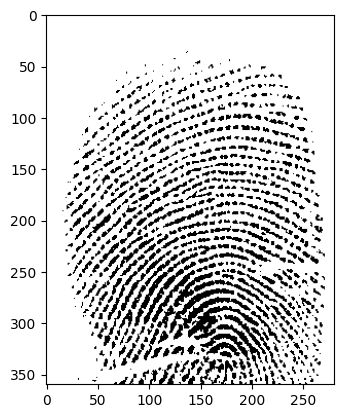

In [ ]:
plt.imshow(bw, cmap='grey')

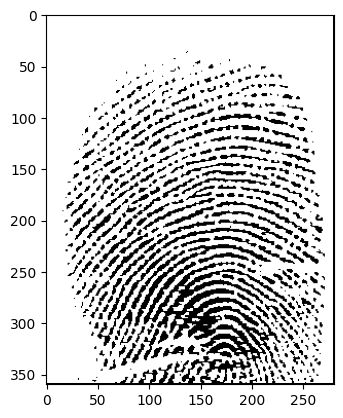

In [ ]:
plt.imshow(clean, cmap='grey')

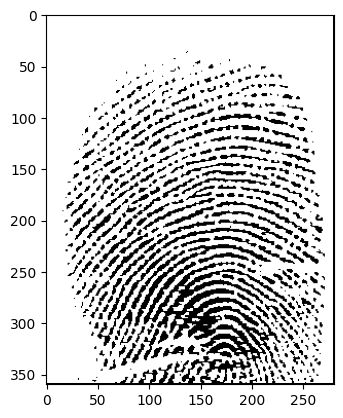

In [ ]:
plt.imshow(clean, cmap='grey')

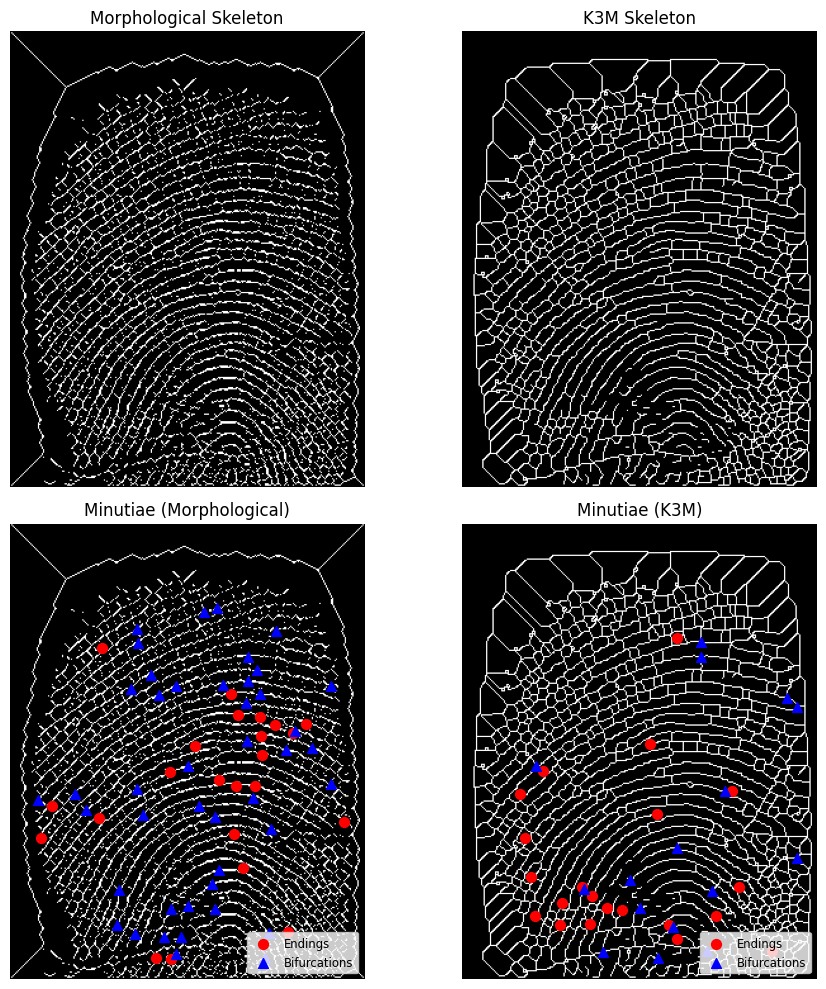

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

axes[0, 0].imshow(skel_ms, cmap='gray')
axes[0, 0].axis('off')
axes[0, 0].set_title('Morphological Skeleton')

axes[0, 1].imshow(skel_k3m, cmap='gray')
axes[0, 1].axis('off')
axes[0, 1].set_title('K3M Skeleton')

detector.visualize_minutiae_on_ax(axes[1, 0], skel_ms, min_ms, title='Minutiae (Morphological)')
detector.visualize_minutiae_on_ax(axes[1, 1], skel_k3m, min_k3m, title='Minutiae (K3M)')

plt.tight_layout()
plt.show()


In [ ]:
path = "/content/drive/MyDrive/biometria/skany/p1_1.bmp"
image = load_image(path)
bw = binarize(image, delta=0.35)
kernel = np.array([
    [0, 0, 0],
    [1, 1, 1],
    [0, 0, 0]
], dtype=np.uint8)

clean = closing(bw, kernel)
ms = MorphologicalSkeleton()
k3m = K3MThinning()
skel_ms = ms.thin(clean.copy())
skel_k3m = k3m.thin(clean.copy())
detector = MinutiaeDetector()
min_ms = detector.detect_minutiae(skel_ms, clean)
min_k3m = detector.detect_minutiae(skel_k3m, clean)

Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.570 to 1.569
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.570 to 1.569
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas


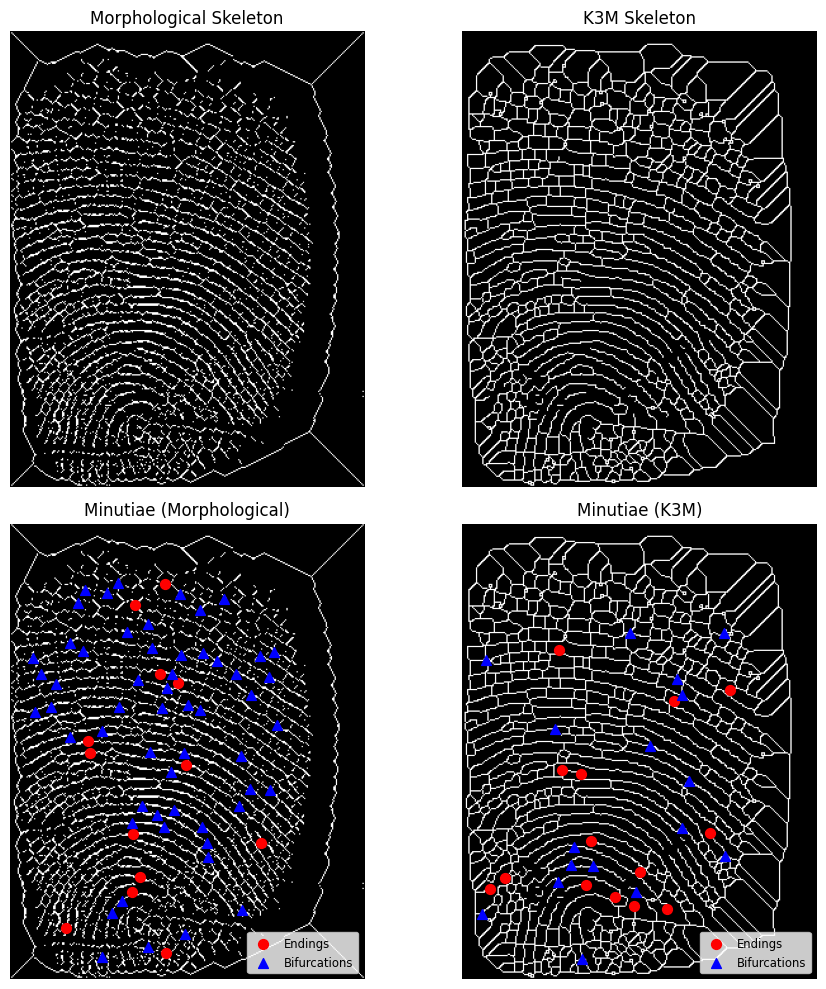

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

axes[0, 0].imshow(skel_ms, cmap='gray')
axes[0, 0].axis('off')
axes[0, 0].set_title('Morphological Skeleton')

axes[0, 1].imshow(skel_k3m, cmap='gray')
axes[0, 1].axis('off')
axes[0, 1].set_title('K3M Skeleton')

detector.visualize_minutiae_on_ax(axes[1, 0], skel_ms, min_ms, title='Minutiae (Morphological)')
detector.visualize_minutiae_on_ax(axes[1, 1], skel_k3m, min_k3m, title='Minutiae (K3M)')

plt.tight_layout()
plt.show()

In [ ]:
path = "/content/drive/MyDrive/biometria/skany/p2_1.bmp"
image = load_image(path)
bw = binarize(image, delta=0.35)
kernel = np.array([
    [0, 0, 0],
    [1, 1, 1],
    [0, 0, 0]
], dtype=np.uint8)

clean = closing(bw, kernel)
ms = MorphologicalSkeleton()
k3m = K3MThinning()
skel_ms = ms.thin(clean.copy())
skel_k3m = k3m.thin(clean.copy())
detector = MinutiaeDetector()
min_ms = detector.detect_minutiae(skel_ms, clean)
min_k3m = detector.detect_minutiae(skel_k3m, clean)

Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.542 to 1.539
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.542 to 1.539
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas


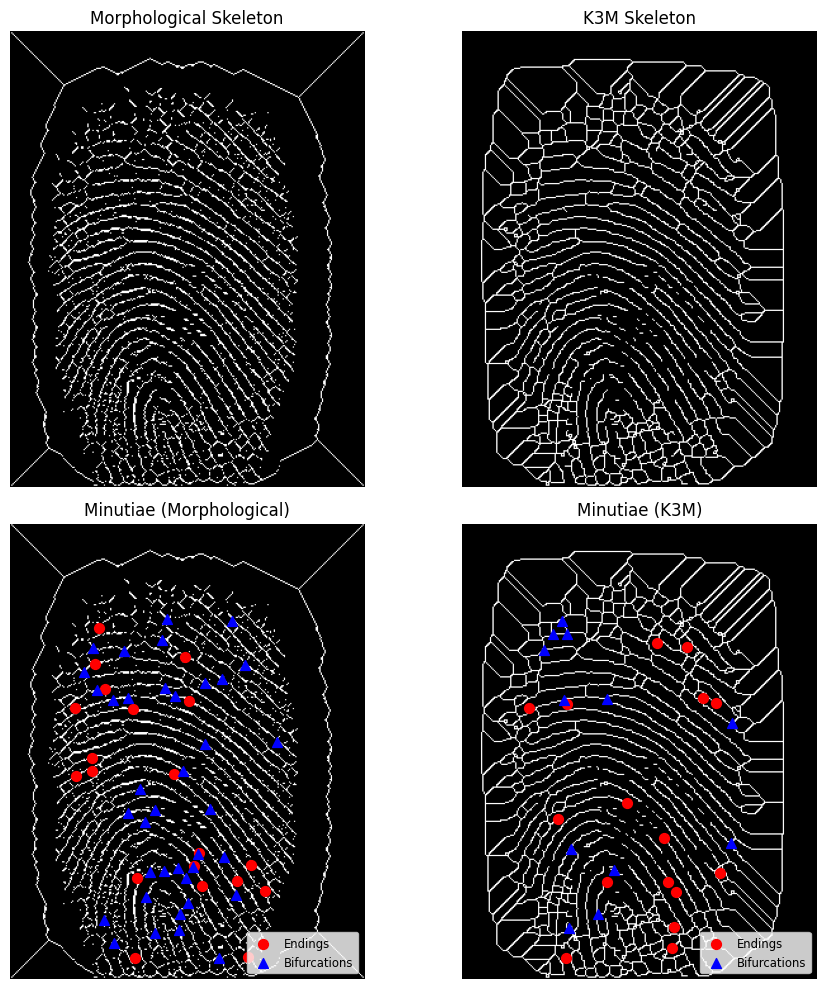

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
axes[0, 0].imshow(skel_ms, cmap='gray')
axes[0, 0].axis('off')
axes[0, 0].set_title('Morphological Skeleton')

axes[0, 1].imshow(skel_k3m, cmap='gray')
axes[0, 1].axis('off')
axes[0, 1].set_title('K3M Skeleton')

detector.visualize_minutiae_on_ax(axes[1, 0], skel_ms, min_ms, title='Minutiae (Morphological)')
detector.visualize_minutiae_on_ax(axes[1, 1], skel_k3m, min_k3m, title='Minutiae (K3M)')

plt.tight_layout()
plt.show()

In [ ]:
path = "/content/drive/MyDrive/biometria/skany/p2_3.bmp"
image = load_image(path)
bw = binarize(image, delta=0.35)
kernel = np.array([
    [0, 0, 0],
    [1, 1, 1],
    [0, 0, 0]
], dtype=np.uint8)

clean = closing(bw, kernel)
ms = MorphologicalSkeleton()
k3m = K3MThinning()
skel_ms = ms.thin(clean.copy())
skel_k3m = k3m.thin(clean.copy())
detector = MinutiaeDetector()
min_ms = detector.detect_minutiae(skel_ms, clean)
min_k3m = detector.detect_minutiae(skel_k3m, clean)

Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.563 to 1.544
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.563 to 1.544
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas


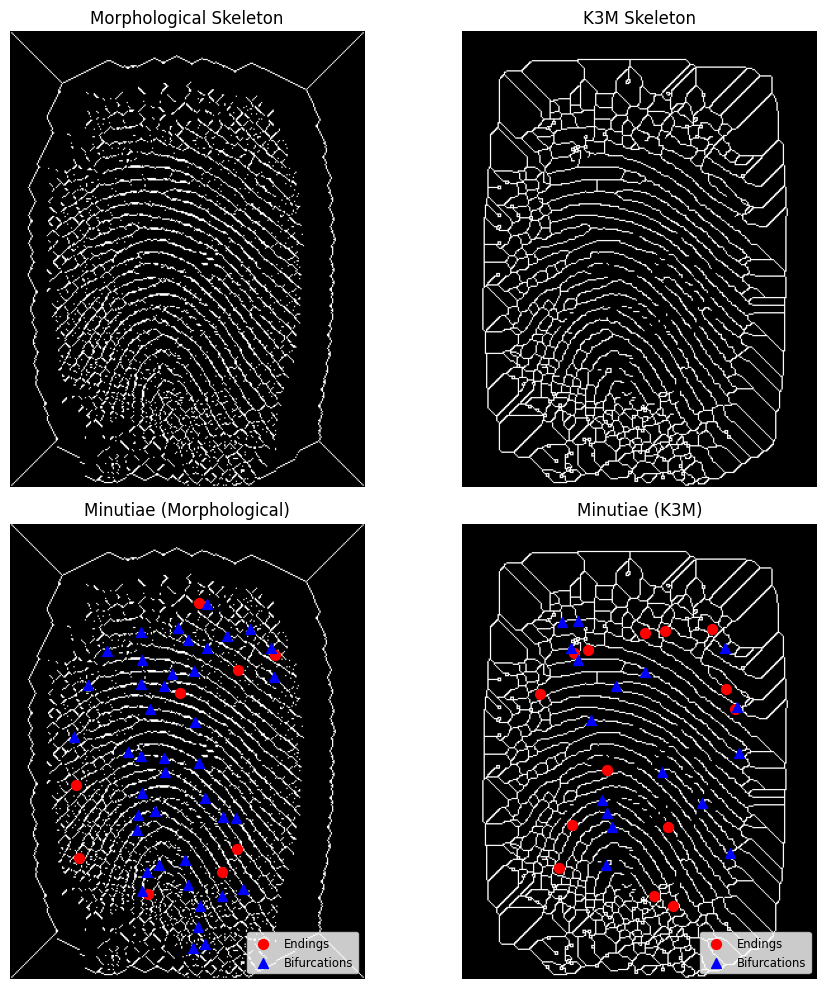

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

axes[0, 0].imshow(skel_ms, cmap='gray')
axes[0, 0].axis('off')
axes[0, 0].set_title('Morphological Skeleton')

axes[0, 1].imshow(skel_k3m, cmap='gray')
axes[0, 1].axis('off')
axes[0, 1].set_title('K3M Skeleton')

detector.visualize_minutiae_on_ax(axes[1, 0], skel_ms, min_ms, title='Minutiae (Morphological)')
detector.visualize_minutiae_on_ax(axes[1, 1], skel_k3m, min_k3m, title='Minutiae (K3M)')

plt.tight_layout()
plt.show()

In [ ]:
def process_and_visualize_arrays(images, delta=0.35):
    detector = MinutiaeDetector()
    ms = MorphologicalSkeleton()
    k3m = K3MThinning()

    kernel = np.array([
        [0, 0, 0],
        [1, 1, 1],
        [0, 0, 0]
    ], dtype=np.uint8)

    num_images = len(images)
    fig, axes = plt.subplots(num_images, 5, figsize=(20, 4 * num_images))

    if num_images == 1:
        axes = np.expand_dims(axes, axis=0)

    for row, image in enumerate(images):
        bw = binarize(image, delta)
        clean = closing(bw, kernel)

        skel_ms = ms.thin(clean.copy())
        skel_k3m = k3m.thin(clean.copy())

        min_ms = detector.detect_minutiae(skel_ms, clean)
        min_k3m = detector.detect_minutiae(skel_k3m, clean)

        axes[row, 0].imshow(image, cmap='gray')
        axes[row, 0].set_title('Original')
        axes[row, 0].axis('off')

        axes[row, 1].imshow(skel_ms, cmap='gray')
        axes[row, 1].set_title('Morphological Skeleton')
        axes[row, 1].axis('off')

        detector.visualize_minutiae_on_ax(axes[row, 2], skel_ms, min_ms, title='Minutiae (MS)')

        axes[row, 3].imshow(skel_k3m, cmap='gray')
        axes[row, 3].set_title('K3M Skeleton')
        axes[row, 3].axis('off')

        detector.visualize_minutiae_on_ax(axes[row, 4], skel_k3m, min_k3m, title='Minutiae (K3M)')

    plt.tight_layout()
    plt.show()


Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.532 to 1.501
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.532 to 1.501
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.542 to 1.430
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.542 to 1.430
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape:

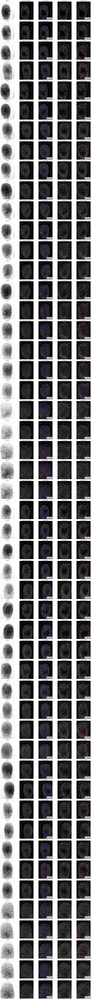

In [ ]:
process_and_visualize_arrays(images)


# testowanie innych delt w binaryzacji


Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.501 to 1.528
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.501 to 1.528
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.540 to 1.396
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.540 to 1.396
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape:

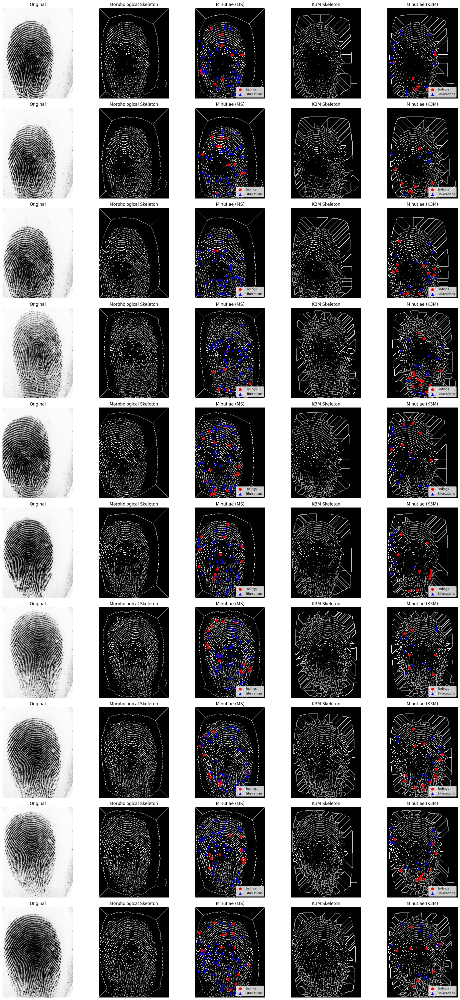

In [ ]:
process_and_visualize_arrays(images[:10], delta = 0.4)

Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.500 to 1.513
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.500 to 1.513
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.543 to 1.522
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.543 to 1.522
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape:

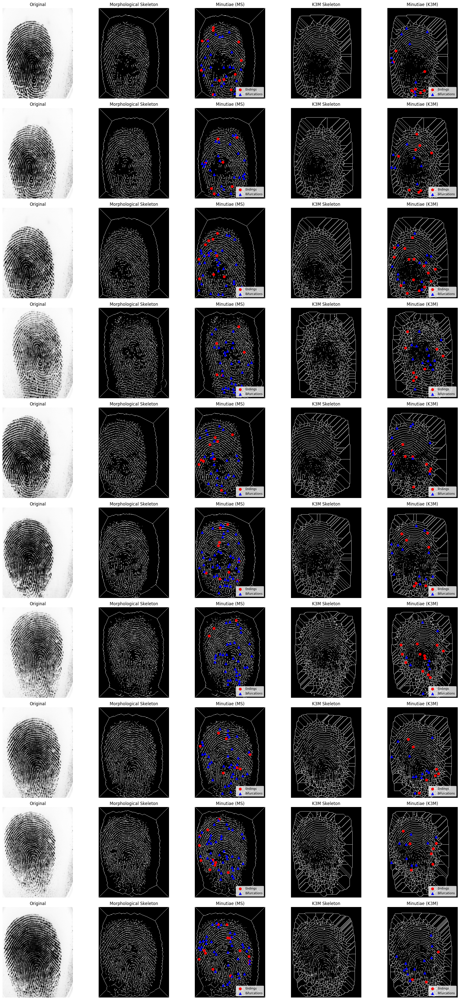

In [ ]:
process_and_visualize_arrays(images[:10], delta = 0.3)

# wersja z adaptacyjną binaryzacją

In [ ]:
def process_and_visualize_arrays_adaptive(images):
    detector = MinutiaeDetector()
    ms = MorphologicalSkeleton()
    k3m = K3MThinning()

    kernel = np.array([
        [0, 0, 0],
        [1, 1, 1],
        [0, 0, 0]
    ], dtype=np.uint8)

    num_images = len(images)
    fig, axes = plt.subplots(num_images, 5, figsize=(20, 4 * num_images))

    if num_images == 1:
        axes = np.expand_dims(axes, axis=0)

    for row, image in enumerate(images):
        bw = binarize_adaptive(images)
        clean = closing(bw, kernel)

        skel_ms = ms.thin(clean.copy())
        skel_k3m = k3m.thin(clean.copy())

        min_ms = detector.detect_minutiae(skel_ms, clean)
        min_k3m = detector.detect_minutiae(skel_k3m, clean)

        # Kolumna 0 – oryginał
        axes[row, 0].imshow(image, cmap='gray')
        axes[row, 0].set_title('Original')
        axes[row, 0].axis('off')

        # Kolumna 1 – szkielet MS
        axes[row, 1].imshow(skel_ms, cmap='gray')
        axes[row, 1].set_title('Morphological Skeleton')
        axes[row, 1].axis('off')

        # Kolumna 2 – minutiae MS
        detector.visualize_minutiae_on_ax(axes[row, 2], skel_ms, min_ms, title='Minutiae (MS)')

        # Kolumna 3 – szkielet K3M
        axes[row, 3].imshow(skel_k3m, cmap='gray')
        axes[row, 3].set_title('K3M Skeleton')
        axes[row, 3].axis('off')

        # Kolumna 4 – minutiae K3M
        detector.visualize_minutiae_on_ax(axes[row, 4], skel_k3m, min_k3m, title='Minutiae (K3M)')

    plt.tight_layout()
    plt.show()


Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.532 to 1.501
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.532 to 1.501
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.542 to 1.430
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape: 22x17
Orientations range: -1.542 to 1.430
Poincaré indices range: -1.000 to 1.000
Found 0 cores and 0 deltas
After edge filtering: 0 cores, 0 deltas
Computing orientation field...
Detecting cores and deltas...
Orientations shape:

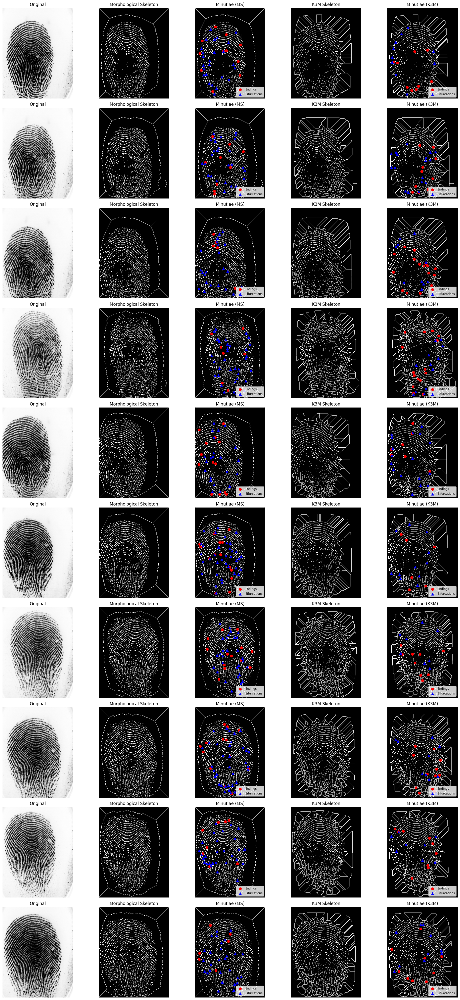

In [ ]:
process_and_visualize_arrays(images[:10])